# CS 436: Final Project
## BLIP Image Captioning
### Eli Sorensen and Natalie Hahle 

### Install Required Dependencies

In [15]:
# install requirements
import sys
if 'google.colab' in sys.modules:
  print('Running in Colab.')
  !pip3 install transformers==4.15.0 timm==0.4.12 fairscale==0.4.4
  !git clone https://github.com/salesforce/BLIP
  %cd BLIP

from google.colab import drive

drive.mount('/content/drive')

Running in Colab.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Cloning into 'BLIP'...
remote: Enumerating objects: 274, done.
remote: Total 274 (delta 0), reused 0 (delta 0), pack-reused 274
Receiving objects: 100% (274/274), 7.16 MiB | 13.38 MiB/s, done.
Resolving deltas: 100% (150/150), done.
/content/BLIP/BLIP
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


### Get Images

Uploade images to `test_data\test_images` in Google Drive

In [3]:
from PIL import Image
import os
import torch
from torchvision import transforms
from torchvision.transforms.functional import InterpolationMode

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

device

device(type='cuda')

In [37]:
def load_images(image_folder, image_size, device):
  images = []
  for image_name in os.listdir('/content/drive/MyDrive/image_data/images/'):
    img_path = os.path.join(image_folder, image_name)
    raw_image = Image.open(img_path).convert('RGB')

    w, h = raw_image.size
    display(raw_image.resize((w // 5, h // 5)))

    transform = transforms.Compose([
        transforms.Resize((image_size, image_size), interpolation=InterpolationMode.BICUBIC),
        transforms.ToTensor(),
        transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711))
    ])

    image = transform(raw_image).unsqueeze(0).to(device)
    images.append(image)
  return images

### Image Captioning

- Perform image captioning using finetuned BLIP model
- Result will save into `test_captions` folder in Google Drive

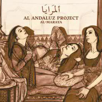

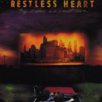

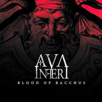

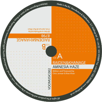

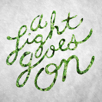

...

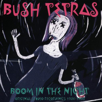

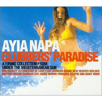

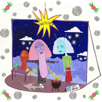

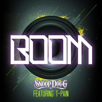

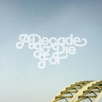

reshape position embedding from 196 to 1024
load checkpoint from https://storage.googleapis.com/sfr-vision-language-research/BLIP/models/model_base_capfilt_large.pth
caption: a group of people sitting on a couch
caption: the cover art for the album
caption: a man with a skull on his head
caption: an orange and white label
caption: a green leaf on a gray background
caption: the cover art for a single album
caption: a col col with various images and text
caption: a black and white silhouette of a deer
caption: a city with many buildings
caption: a deer in the woods
caption: a man riding a bike with a woman on the back
caption: a person kneeling on the ground
caption: the number seven with the sky in the background
caption: a person sitting on a bed
caption: a pixel pixel pixel pixel pixel pixel pixel pixel pixel pixel pixel pixel pixel pixel pixel pixel pixel
caption: two women looking at each other women
caption: a tree in the fog
caption: a fire with the words, `, `, `, `, `, `, `, `, 

In [38]:
from models.blip import blip_decoder

image_size = 512
images = load_images('/content/drive/My Drive/image_data/images', image_size=image_size, device=device)

model_url = 'https://storage.googleapis.com/sfr-vision-language-research/BLIP/models/model_base_capfilt_large.pth'
model = blip_decoder(pretrained=model_url, image_size=image_size, vit='base')
model.eval()
model = model.to(device)

text_folder = '/content/drive/My Drive/image_data/captions'
if not os.path.exists(text_folder):
  os.makedirs(text_folder)

with torch.no_grad():
  for i, image in enumerate(images):
    caption = model.generate(image, sample=False, num_beams=3, max_length=100, min_length=5)
    print('caption: ' + caption[0])
    image_name = os.listdir('/content/drive/My Drive/image_data/images/')[i]
    image_name = os.path.splitext(image_name)[0]
    with open(os.path.join(text_folder, f"{image_name}.txt"), "w") as f:
      f.write(caption[0])